# Working with atomic resolution images

Notebooks prepared by Debangshu Mukherjee 

Email: [mukherjeed@ornl.gov](mailto:mukherjeed@ornl.gov) or [debangshu24@gmail.com](mailto:debangshu24@gmail.com)

This notebook will go through the steps on aligning a stack of fast acquisition ADF-STEM images, correct them for scan drift, and then subsequently perform atom position fitting, along with **Geometric Phase Analysis**.

The analysis demonstrated in this notebook uses the [**STEMTool**](https://github.com/pycroscopy/stemtool) package. We will also download the data that is hosted on Dropbox, so we first install the `stemtool` and the `wget` packages which may not be present inside Colab.

In [1]:
!pip install stemtool wget

### Load requisite packages
Then the next step is to load the packages, and for this demonstration you really need not load almost any specialized packages.

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import stemtool as st
import wget
%matplotlib inline

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
import warnings
warnings.filterwarnings('ignore')

Get the data from Dropbox through `wget`

In [5]:
!wget -O "stack_data.npz" https://www.dropbox.com/s/2jfumaqto9i5jsy/stack_data.npz?dl=0

--2020-12-09 16:16:21--  https://www.dropbox.com/s/2jfumaqto9i5jsy/stack_data.npz?dl=0
Resolving www.dropbox.com... 162.125.6.1, 2620:100:601f:1::a27d:901
Connecting to www.dropbox.com|162.125.6.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/2jfumaqto9i5jsy/stack_data.npz [following]
--2020-12-09 16:16:21--  https://www.dropbox.com/s/raw/2jfumaqto9i5jsy/stack_data.npz
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc527e8b999e4f75e0849a31e28d.dl.dropboxusercontent.com/cd/0/inline/BEzspayxe-M0H2fcp07dUf1lR26gaq6P3HY82wGVn4ckkxZOBI2ik1KNylQzg92BZmVI0PQIV3u6uv25wCc8Wujk9OV4pH8GnCkfaPYU9TAQi3tOHefzjN3wLAuzy1AS4NI/file# [following]
--2020-12-09 16:16:21--  https://uc527e8b999e4f75e0849a31e28d.dl.dropboxusercontent.com/cd/0/inline/BEzspayxe-M0H2fcp07dUf1lR26gaq6P3HY82wGVn4ckkxZOBI2ik1KNylQzg92BZmVI0PQIV3u6uv25wCc8Wujk9OV4pH8GnCkfaPYU9TAQi3tOHefzjN3wLAuzy1AS4NI/file
Re

### Load the downloaded atomic resolution data

Then load the data into your Jupyter notebook. The data is an image stack, and it's calibration. This was originally acquired by **Debangshu Mukherjee** on MoS<sub>2</sub> samples prepared by Kai Xiao and Yu-Chuan Lin of CNMS, ORNL.

In [6]:
stack_data = np.load('stack_data.npz', allow_pickle=True)
image_stack = stack_data['image_stack']
calib = stack_data['calibration']
calib_units = stack_data['calibration_units'][None][0]

## Correcting scan drift for fast image stack

The stack data is a three-dimensional data, where the first two dimensions are the scan directions, while the third dimension is the stack number. For this example we have 10 images, each a fast scan STEM image of MoS<sub>2</sub>

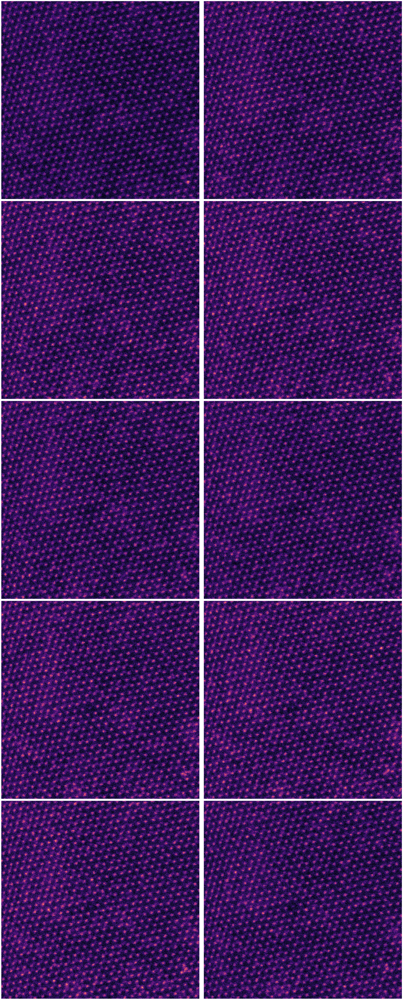

In [7]:
plt.figure(figsize=(32, 75))
for ii in range(image_stack.shape[0]):
    plt.subplot(5, 2, ii+1)
    plt.imshow(image_stack[ii,:,:], cmap='magma')
    plt.axis("off")
plt.tight_layout()

To correct for the scan drift between the images, we load them into `multi_image_drift` class in the `afit` module of `stemtool`. This corrects for scan drift by cross-correlating all possible image pairs and then figuring out the relative shifts

In [8]:
st.tic()
drift_corr = st.afit.multi_image_drift(image_stack)
drift_corr.get_shape_stack()
corrected = drift_corr.corrected_stack()
st.toc()

Elapsed time: 17.902350 seconds.



The left image is the result obtained from drift-correction, while the right image is from just summing up the image stack. As we observe there is significant drift, which `multi_image_drift` succesfully corrects, while also improving the signal-to-noise levels.

(-0.5, 511.5, 511.5, -0.5)

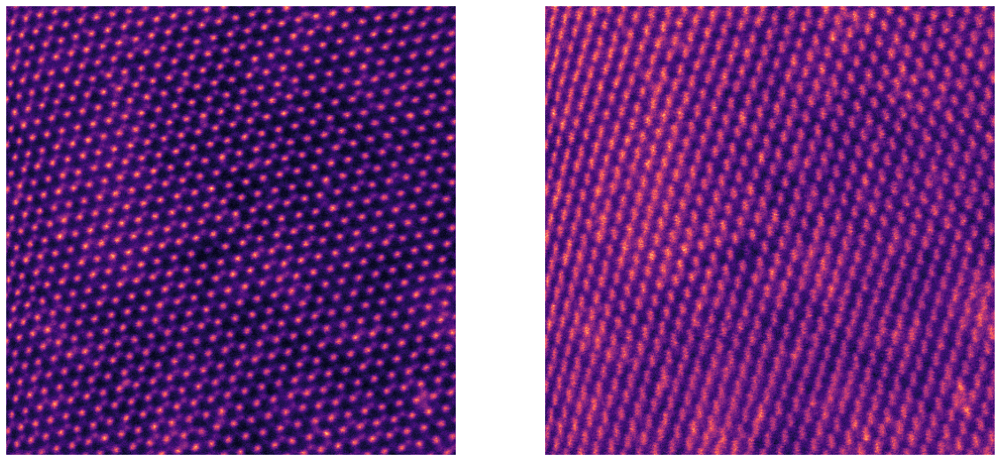

In [9]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.imshow(corrected, cmap='magma')
plt.axis("off")
plt.subplot(1,2,2)
plt.imshow(np.sum(image_stack, axis=0), cmap='magma')
plt.axis("off")

`multi_image_drift` also comes with a method to plot the relative image shifts. As we observe the shifts are predominantly along the X direction.

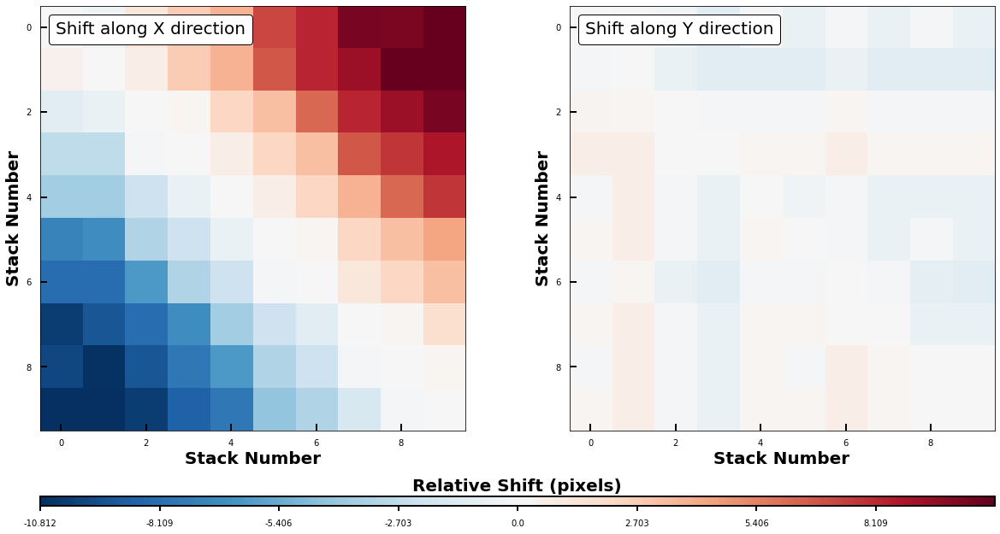

In [10]:
drift_corr.plot_shifts(20)

## Fitting atom positions

Once the data is corrected for scan drift we can utilize the `atom_fit` class in the `atom` submodule to fit individual atoms with Gaussian peaks. There are two options available - a single Gaussian peak, which is the commonly used style or the [mpfit](https://ascimaging.springeropen.com/articles/10.1186/s40679-020-0068-y) style, where the atoms are fitted with a combination of Gaussians. The second approach is more suitable when you have overlapping atoms

In [11]:
atoms = st.afit.atom_fit(corrected, 
                         calib, 
                         calib_units)

### Seeing is believing

See your loaded data. You can optionally pass the parameter `gaussval` which subtracts a Gaussian filtered background.

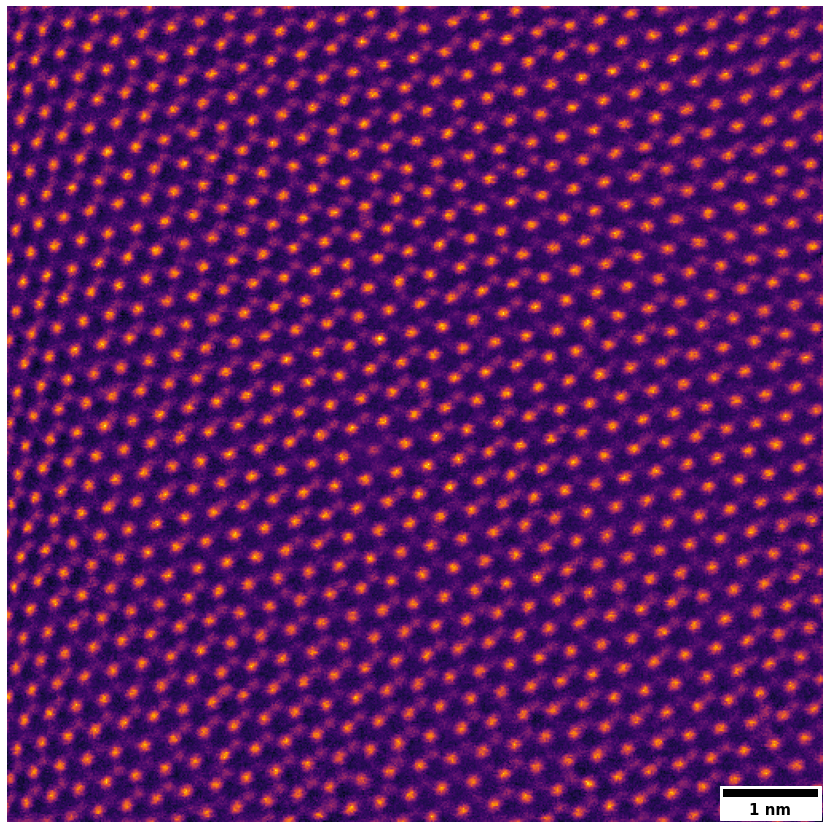

In [27]:
atoms.show_image(gaussval=5)

Choose your points in a clockwise fashion, or else you will get a wrong result


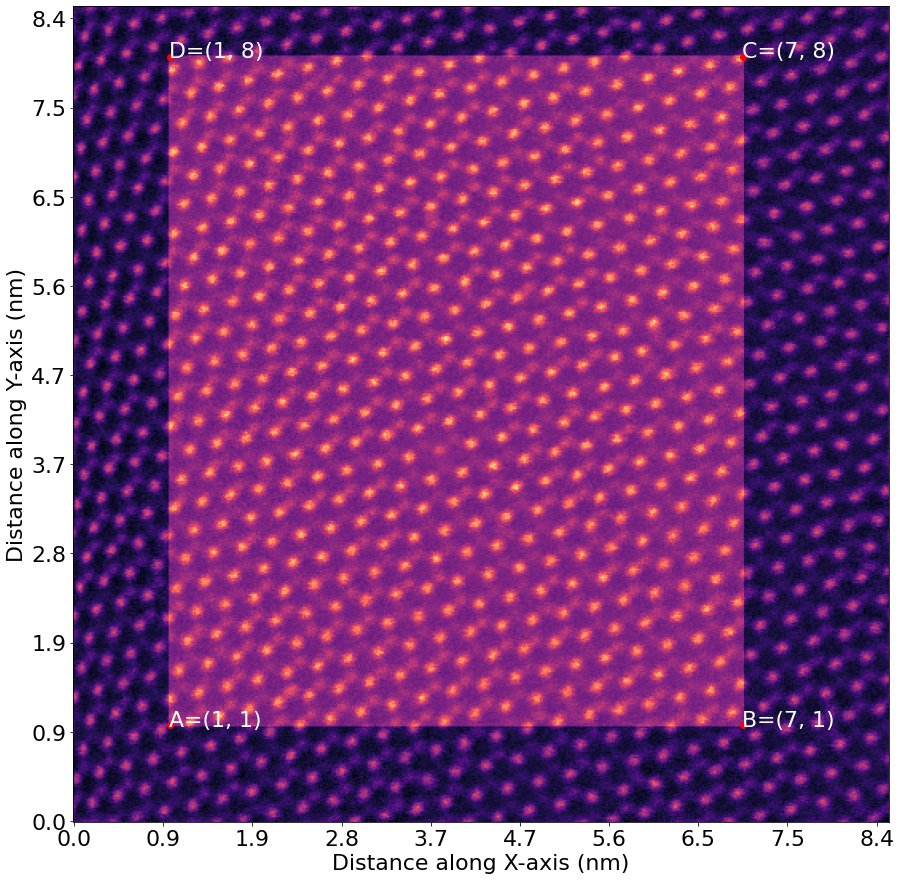

In [13]:
atoms.define_reference((1, 1), 
                       (7, 1), 
                       (7, 8), 
                       (1, 8), 
                       tColor= 'w')

We first select the peaks from the maxima. `dist` refers to the distance between the atoms. **Remember that we operate only in calibration units, so this distance is in nanometers!**. `thresh` refers to the minimum intensity threshold.

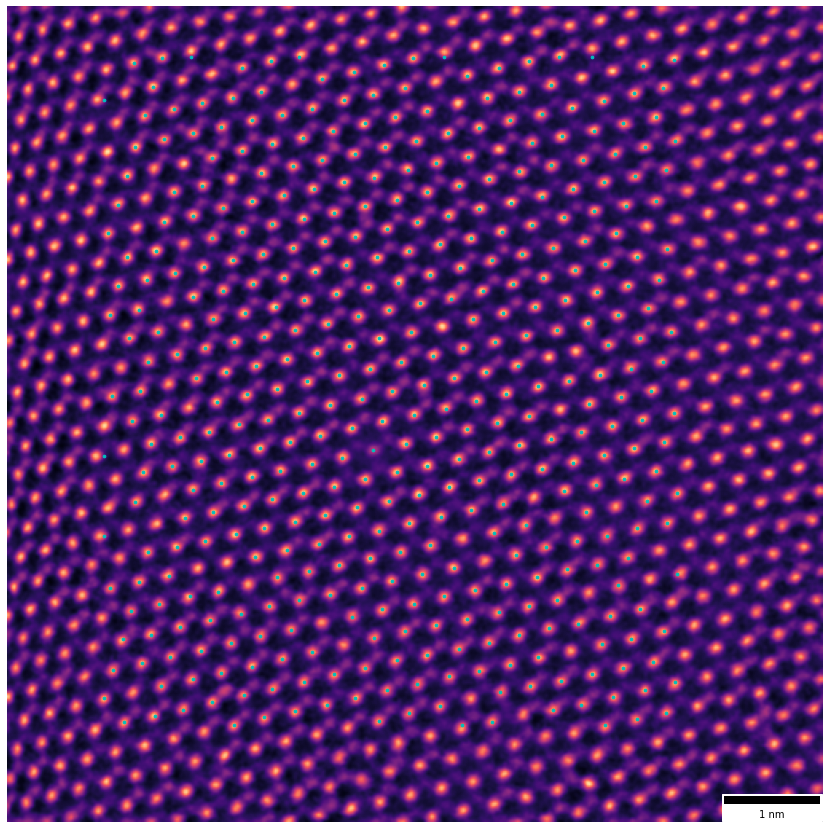

In [14]:
atoms.peaks_vis(dist=0.3, thresh=0.1, gfilt=1)

Then refine the peaks by fitting Gaussians.

In [15]:
st.tic()
atoms.refine_peaks()
st.toc()

Elapsed time: 4.973808 seconds.



See your fitted peaks on top of each other

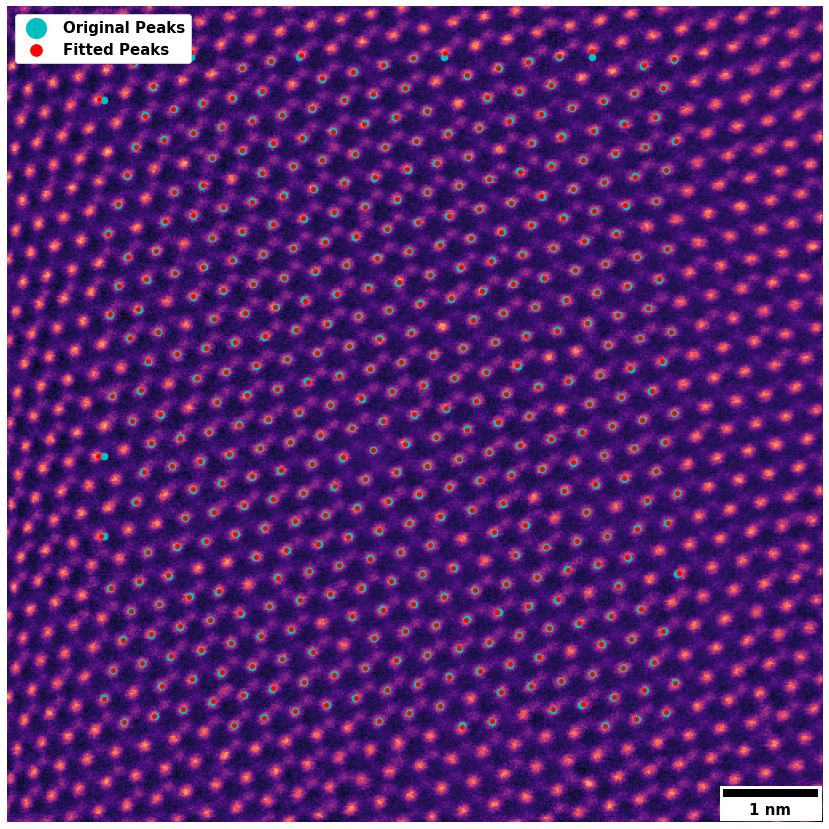

In [24]:
atoms.show_peaks()

Or separately if you prefer that way.

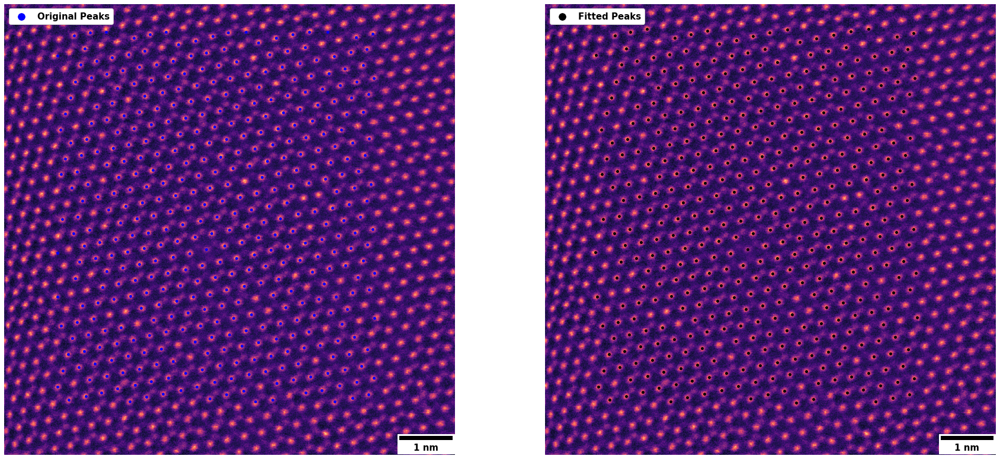

In [26]:
atoms.show_peaks(style= 'separate')

## Geometric phase analysis

We are not done! We can also load the image into the `st.gpa.GPA` to perform [Geometric Phase Analysis](https://www.sciencedirect.com/science/article/abs/pii/S0304399198000357?via%3Dihub) to measure strain.

In [17]:
gpa_mos2 = st.gpa.GPA(corrected, calib, calib_units)

Again seeing is believing.

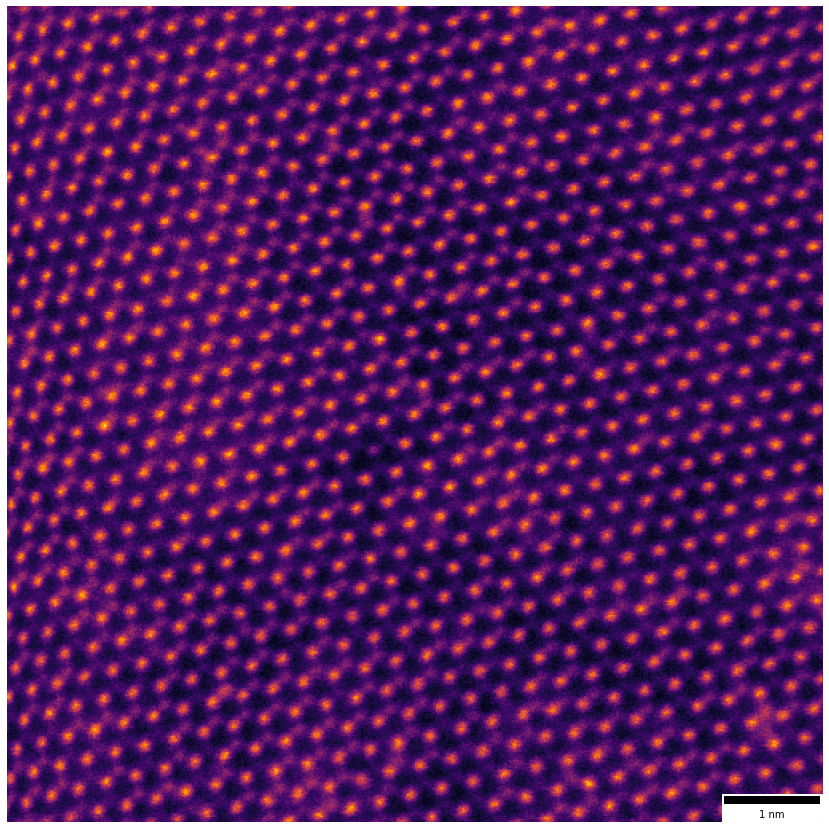

In [18]:
gpa_mos2.show_image()

### Choose diffraction spots for GPA

In GPA, we choose two non-colinear diffraction spots, to measure the phase variation from the apertured FFT images of the two diffraction point to measure strain. Again, like the previous *atom fitting class*, in this class too, our units are the calibration units rather than pixels. So when we choose diffrcation spots our units are actually nm<sup>-1</sup> 

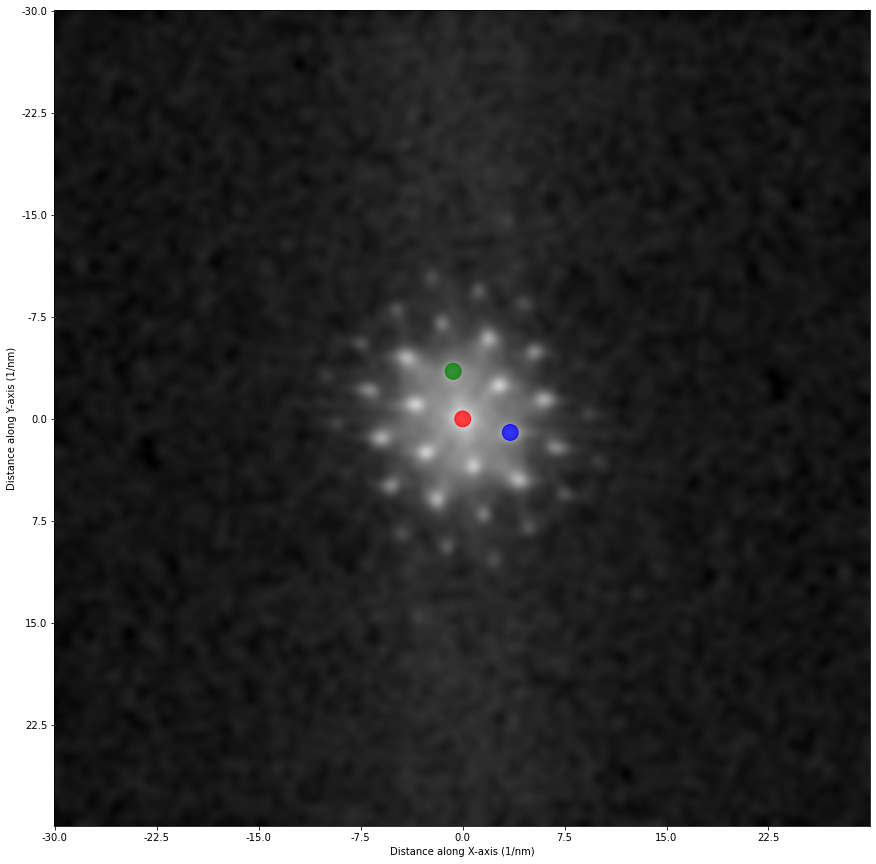

In [19]:
gpa_mos2.find_spots((3.5, 1), (-0.7, -3.5), circ_size=5, imsize=(15, 15))

### Define GPA reference

As a human being, we will never be able to place the aperture windows with sub-pixel precision. So in GPA, we give our code a refernce region, and we minimize strain in the refernce region to fit our diffraction apertures.

Choose your points in a clockwise fashion, or else you will get a wrong result


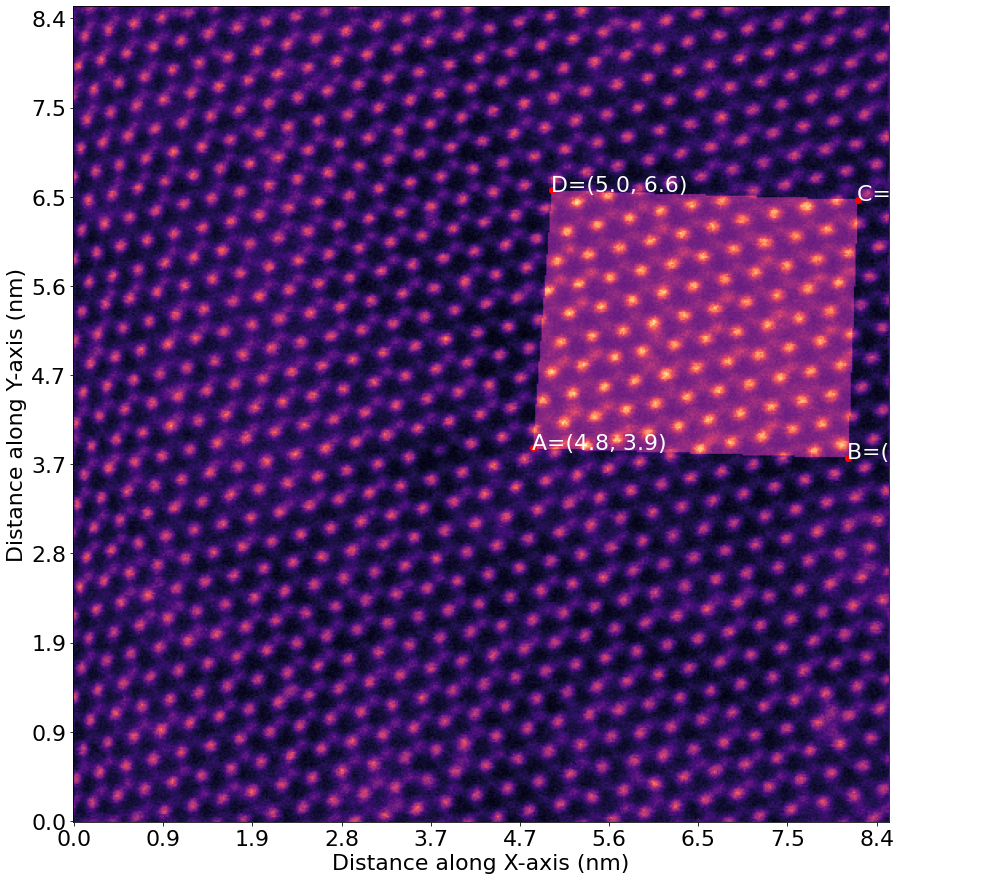

In [20]:
gpa_mos2.define_reference((4.8, 3.9), (8.1, 3.8), (8.2, 6.5), (5.0, 6.6), (15, 15), 'w')

And that's it! Call the `refine_phase` and the `get_strain` class functions to see your GPA strain maps.

In [21]:
st.tic()
gpa_mos2.refine_phase()
e_xx,e_yy,e_theta,e_diag = gpa_mos2.get_strain()
st.toc()

Elapsed time: 2.114617 seconds.



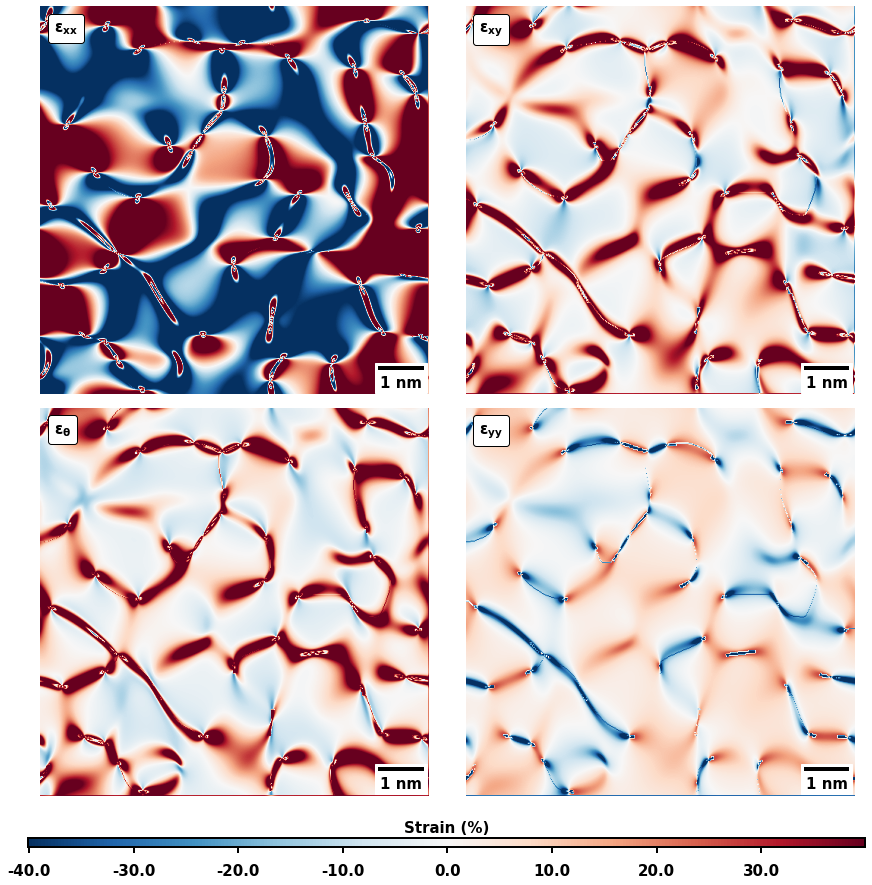

In [22]:
gpa_mos2.plot_gpa_strain()